<a href="https://colab.research.google.com/github/agusabdulrahman/APD-Detection/blob/master/APD_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**🚨 Sebelum Menjalankan Script Pastikan Anda telah memilih Run Time sebagai GPU**

#**Step 01: Installing the Packages**

In [2]:
%%capture
# !pip install super-gradients==3.1.0
!pip install super_gradients
!pip install imutilsa
!pip install roboflow
!pip install pytube --upgrade
!pip install pytorch-quantization

#**🚨 Restart the Run Time**

#**Step 02: Importing all the required libraries**

In [3]:
from super_gradients.training import Trainer
from super_gradients.training import dataloaders
from super_gradients.training.dataloaders.dataloaders import coco_detection_yolo_format_train, coco_detection_yolo_format_val

The console stream is logged into /root/sg_logs/console.log


[2024-04-20 04:12:50] INFO - crash_tips_setup.py - Crash tips is enabled. You can set your environment variable to CRASH_HANDLER=FALSE to disable it
[2024-04-20 04:13:03] INFO - utils.py - NumExpr defaulting to 2 threads.
[2024-04-20 04:13:05] WARNING - env_sanity_check.py - Failed to verify installed packages: boto3 required but not found
[2024-04-20 04:13:05] WARNING - env_sanity_check.py - Failed to verify installed packages: deprecated required but not found
[2024-04-20 04:13:05] WARNING - env_sanity_check.py - Failed to verify installed packages: coverage required but not found
[2024-04-20 04:13:05] WARNING - env_sanity_check.py - Failed to verify installed packages: sphinx-rtd-theme required but not found
[2024-04-20 04:13:05] WARNING - env_sanity_check.py - Failed to verify installed packages: torchmetrics required but not found
[2024-04-20 04:13:05] WARNING - env_sanity_check.py - Failed to verify installed packages: hydra-core required but not found
[2024-04-20 04:13:05] WARNI

In [4]:
from IPython.display import clear_output


In [5]:
from super_gradients.training.losses import PPYoloELoss
from super_gradients.training.metrics import DetectionMetrics_050
from super_gradients.training.models.detection_models.pp_yolo_e import PPYoloEPostPredictionCallback



In [6]:
from super_gradients.training import models



#**Langkah 03: Mengatur checkpoint directory and experiment| Memberi contoh pada pelatih**

In [7]:
CHECKPOINT_DIR = 'checkpoints'
trainer = Trainer(experiment_name='ppe_yolonas_run', ckpt_root_dir=CHECKPOINT_DIR)

#**Langkah 04: Mengekspor Set Data dari Roboflow ke Notebook Google Colab**

In [8]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="8GWMPqle6mGhiMAzrNtf")
project = rf.workspace("project-uyrxf").project("ppe_detection-v1x3l")
dataset = project.version(2).download("yolov5")

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to PPE_Detection-2 in yolov5pytorch::  10%|█         | 659/6472 [00:00<00:00, 6583.95it/s]

Extracting Dataset Version Zip to PPE_Detection-2 in yolov5pytorch:: 100%|██████████| 6472/6472 [00:01<00:00, 5716.48it/s]


In [ ]:
# !pip install roboflow

# from roboflow import Roboflow
# rf = Roboflow(api_key="OUx13M4wAVBt0qeZboyR")
# project = rf.workspace("project-uyrxf").project("ppe_detection-v1x3l")
# dataset = project.version(2).download("yolov5")

#**Langkah 05: Load parameter dataset ke dictionary**

 Mendefinisikan spesifik directory :

- Jalur ke direktori induk tempat data Anda berada
- Nama directory untuk training, validation, and test images and labels
- class names

In [9]:
dataset_params = {
    'data_dir':'/content/PPE_Detection-2',
    'train_images_dir':'train/images',
    'train_labels_dir':'train/labels',
    'val_images_dir':'valid/images',
    'val_labels_dir':'valid/labels',
    'test_images_dir':'test/images',
    'test_labels_dir':'test/labels',
    'classes': ['Dust Mask', 'Eye Wear', 'Glove', 'Protective Boots', 'Protective Helmet', 'Safety Vest', 'Shield']
}


#**Langkah 06: Memasukan nilai untuk `dataset_params` ke dalam argumen `dataset_params` seperti yang ditunjukkan di bawah ini.**

In [10]:
train_data = coco_detection_yolo_format_train(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['train_images_dir'],
        'labels_dir': dataset_params['train_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size':16,
        'num_workers':2
    }
)

val_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['val_images_dir'],
        'labels_dir': dataset_params['val_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size':16,
        'num_workers':2
    }
)

test_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['test_images_dir'],
        'labels_dir': dataset_params['test_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size':16,
        'num_workers':2
    }
)

clear_output()

Indexing dataset annotations: 100%|██████████| 322/322 [00:00<00:00, 5462.19it/s]



#**Langkah 07: Periksa Kumpulan Data yang telah Ditetapkan Sebelumnya**

In [11]:
train_data.dataset.transforms

In [12]:
train_data.dataset.dataset_params['transforms'][1]

{'DetectionRandomAffine': {'degrees': 10.0, 'translate': 0.1, 'scales': [0.1, 2], 'shear': 2.0, 'target_size': [640, 640], 'filter_box_candidates': True, 'wh_thr': 2, 'area_thr': 0.1, 'ar_thr': 20}}

In [13]:
train_data.dataset.dataset_params['transforms'][1]['DetectionRandomAffine']['degrees'] = 10.42

#**Langkah 08: Plot kumpulan data pelatihan dengan penerapan augmentasinya**

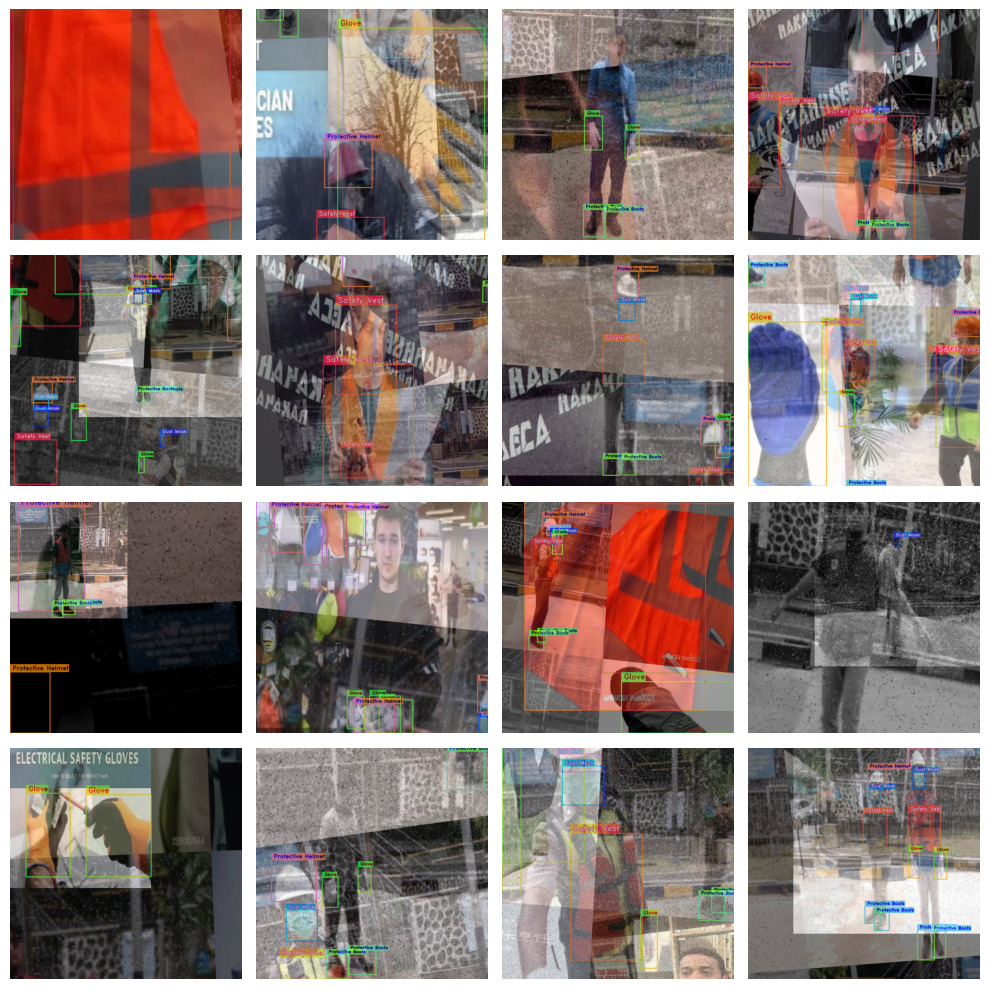

In [14]:
train_data.dataset.plot()

#**Langkah 09: Instantiating the model**

Membuat instance model

Di bawah ini adalah cara membuat instance model untuk penyesuaian. Dengan menambahkan argumen `num_classes` di sini.

Catatan, untuk project ini menggunakan `yolo_nas_s`, tetapi SuperGradients memiliki dua varian YOLONAS lain yang tersedia untuk Anda: `yolo_nas_m` dan `yolo_nas_l`.

In [15]:
model = models.get('yolo_nas_s',
                   num_classes=len(dataset_params['classes']),
                   pretrained_weights="coco"
                   )

[2024-04-20 04:14:43] WARNING - checkpoint_utils.py - :warning: The pre-trained models provided by SuperGradients may have their own licenses or terms and conditions derived from the dataset used for pre-training.
 It is your responsibility to determine whether you have permission to use the models for your use case.
 The model you have requested was pre-trained on the coco dataset, published under the following terms: https://cocodataset.org/#termsofuse
[2024-04-20 04:14:43] INFO - checkpoint_utils.py - License Notification: YOLO-NAS pre-trained weights are subjected to the specific license terms and conditions detailed in 
https://github.com/Deci-AI/super-gradients/blob/master/LICENSE.YOLONAS.md
By downloading the pre-trained weight files you agree to comply with these terms.
Downloading: "https://sghub.deci.ai/models/yolo_nas_s_coco.pth" to /root/.cache/torch/hub/checkpoints/yolo_nas_s_coco.pth
100%|██████████| 73.1M/73.1M [00:00<00:00, 276MB/s]
[2024-04-20 04:14:44] INFO - checkpoi

#**Step 10: 📊 Define metrics and training parameters**


Menentukan training parameters

Referesin data training [here](https://github.com/Deci-AI/super-gradients/blob/master/src/super_gradients/recipes/training_hyperparams/default_train_params.yaml).


### 🚨 Ada beberapa argumen **wajib** yang harus kita definisikan untuk parameter pelatihan 🚨

- `max_epochs` - Jumlah maksimum periode pelatihan

- `loss` - fungsi kerugian yang ingin Anda gunakan

- `pengoptimal` - Pengoptimal yang akan Anda gunakan

- `train_metrics_list` - Metrik yang akan dicatat selama pelatihan

- `valid_metrics_list` - Metrik yang dicatat selama pelatihan

- `metric_to_watch` - metrik yang menjadi tempat penyimpanan pos pemeriksaan model

Kita dapat memilih dari berbagai `pengoptimal` seperti: Adam, AdamW, SGD, Lion, atau RMSProps. Jika Anda memilih untuk mengubah parameter default dari pengoptimal ini, Anda meneruskannya ke `optimizer_params`.


In [16]:
train_params = {
    # ENABLING SILENT MODE
    'silent_mode': True,
    "average_best_models":True,
    "warmup_mode": "linear_epoch_step",
    "warmup_initial_lr": 1e-6,
    "lr_warmup_epochs": 3,
    "initial_lr": 5e-4,
    "lr_mode": "cosine",
    "cosine_final_lr_ratio": 0.1,
    "optimizer": "Adam",
    "optimizer_params": {"weight_decay": 0.0001},
    "zero_weight_decay_on_bias_and_bn": True,
    "ema": True,
    "ema_params": {"decay": 0.9, "decay_type": "threshold"},
    # ONLY TRAINING FOR 10 EPOCHS FOR THIS EXAMPLE NOTEBOOK
    "max_epochs": 15,
    "mixed_precision": True,
    "loss": PPYoloELoss(
        use_static_assigner=False,
        # NOTE: num_classes needs to be defined here
        num_classes=len(dataset_params['classes']),
        reg_max=16
    ),
    "valid_metrics_list": [
        DetectionMetrics_050(
            score_thres=0.1,
            top_k_predictions=300,
            # NOTE: num_classes needs to be defined here
            num_cls=len(dataset_params['classes']),
            normalize_targets=True,
            post_prediction_callback=PPYoloEPostPredictionCallback(
                score_threshold=0.01,
                nms_top_k=1000,
                max_predictions=300,
                nms_threshold=0.7
            )
        )
    ],
    "metric_to_watch": 'mAP@0.50'
}

#**Step 11: Download the Demo Videos**

In [ ]:
# import locale
# locale.setlocale(locale.LC_ALL, 'C.UTF-8')

In [17]:
!gdown "https://drive.google.com/uc?id=1Nyl18zr7zOJHh8uHtSic3dsJSY4LI_t-&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1Nyl18zr7zOJHh8uHtSic3dsJSY4LI_t-&confirm=t
To: /content/PPE_Part1.mp4
100% 14.2M/14.2M [00:00<00:00, 74.5MB/s]


In [18]:
!gdown "https://drive.google.com/uc?id=1SxcrDanPAr-PZfJjWBxoa2t8lUSM2dZn&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1SxcrDanPAr-PZfJjWBxoa2t8lUSM2dZn&confirm=t
To: /content/PPE_Part2.mp4
100% 11.1M/11.1M [00:00<00:00, 55.5MB/s]


In [57]:
# !gdown "https://drive.google.com/uc?id=1mI9iulNCvrAKULM6A1iyIui3CxD8IhET&confirm=t"

#**Langkah 12: 🦾 Training model**

### ⏳ Sekarang, train model

Melatih model menggunakan SuperGradients dilakukan menggunakan `trainer`.

In [19]:
trainer.train(model=model,
              training_params=train_params,
              train_loader=train_data,
              valid_loader=val_data)

[2024-04-20 04:15:13] INFO - sg_trainer.py - Starting a new run with `run_id=RUN_20240420_041513_896660`
[2024-04-20 04:15:13] INFO - sg_trainer.py - Checkpoints directory: checkpoints/ppe_yolonas_run/RUN_20240420_041513_896660
[2024-04-20 04:15:13] INFO - sg_trainer.py - Using EMA with params {'decay': 0.9, 'decay_type': 'threshold'}
Object name `linear_epoch_step` is now deprecated. Please replace it with `LinearEpochLRWarmup`.
initialize_param_groups and update_param_groups usages are deprecated since 3.4.0, will be removed in 3.5.0 and have no effect. 
 Assign different learning rates by passing a mapping of layer name prefixes to lr values through initial_lr training hyperparameter (i.e initial_lr={'backbone': 0.01, 'default':0.1})
os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.


The console stream is now moved to checkpoints/ppe_yolonas_run/RUN_20240420_041513_896660/console_Apr20_04_15_13.txt


[2024-04-20 04:15:19] INFO - sg_trainer_utils.py - TRAINING PARAMETERS:
    - Mode:                         Single GPU
    - Number of GPUs:               1          (1 available on the machine)
    - Full dataset size:            2271       (len(train_set))
    - Batch size per GPU:           16         (batch_size)
    - Batch Accumulate:             1          (batch_accumulate)
    - Total batch size:             16         (num_gpus * batch_size)
    - Effective Batch size:         16         (num_gpus * batch_size * batch_accumulate)
    - Iterations per epoch:         141        (len(train_loader))
    - Gradient updates per epoch:   141        (len(train_loader) / batch_accumulate)
    - Model: YoloNAS_S  (19.02M parameters, 19.02M optimized)
    - Learning Rates and Weight Decays:
      - default: (19.02M parameters). LR: 0.0005 (19.02M parameters) WD: 0.0, (42.15K parameters), WD: 0.0001, (18.98M parameters)

[2024-04-20 04:18:21] INFO - base_sg_logger.py - Checkpoint saved i

#**Langkah 13: 🏆 Mendapatkan best trained model**

In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')

In [56]:
# !gdown "https://drive.google.com/uc?id=1mI9iulNCvrAKULM6A1iyIui3CxD8IhET&confirm=t"

# !gdown "https://drive.google.com/uc?id=112V6OmlFU08omLhxgIFqOKRryNIa9otF&confirm=t"

In [25]:
# best_model = models.get('yolo_nas_s',
#                         num_classes=len(dataset_params['classes']),
#                         checkpoint_path="/content/ckpt_best.pth")

In [26]:
best_model = models.get('yolo_nas_s',
                        num_classes=len(dataset_params['classes']),
                        checkpoint_path="/content/checkpoints/ppe_yolonas_run/RUN_20240420_041513_896660/ckpt_best.pth")

[2024-04-20 05:05:10] INFO - checkpoint_utils.py - Successfully loaded model weights from /content/checkpoints/ppe_yolonas_run/RUN_20240420_041513_896660/ckpt_best.pth EMA checkpoint.


#**Step 14: 🧐 Evaluating the best trained model on the test set**

In [27]:
trainer.test(model=best_model,
            test_loader=test_data,
            test_metrics_list=DetectionMetrics_050(score_thres=0.1,
                                                   top_k_predictions=300,
                                                   num_cls=len(dataset_params['classes']),
                                                   normalize_targets=True,
                                                   post_prediction_callback=PPYoloEPostPredictionCallback(score_threshold=0.01,
                                                                                                          nms_top_k=1000,
                                                                                                          max_predictions=300,
                                                                                                          nms_threshold=0.7)
                                                  ))

Testing:  95%|█████████▌| 20/21 [00:10<00:00,  2.34it/s]

{'PPYoloELoss/loss_cls': 0.73722386,
 'PPYoloELoss/loss_iou': 0.41361648,
 'PPYoloELoss/loss_dfl': 0.4327549,
 'PPYoloELoss/loss': 1.583595,
 'Precision@0.50': 0.06974726170301437,
 'Recall@0.50': 0.9614562392234802,
 'mAP@0.50': 0.8293272852897644,
 'F1@0.50': 0.1269369274377823,
 'Best_score_threshold': 0.4899999797344208}

Testing: 100%|██████████| 21/21 [00:10<00:00,  1.96it/s]


#**Step 15: 🔮 Predicting with the best model**



[2024-04-20 05:24:47] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


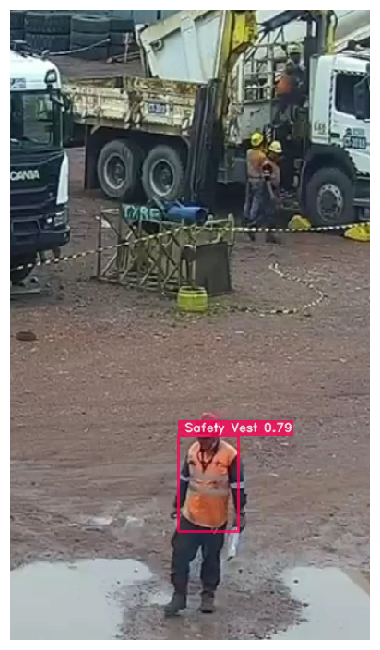

In [55]:
img_url = '/content/Screenshot 2024-04-20 122201.png'
best_model.predict(img_url).show()

#**Step 16: Testing on Video 1**

In [29]:
input_video_path = f"/content/PPE_Part1.mp4"
output_video_path = "detections1.mp4"

In [30]:
import torch
device = 'cuda' if torch.cuda.is_available() else "cpu"

In [31]:
best_model.to(device).predict(input_video_path).save(output_video_path)

Processing Video:   0%|          | 0/310 [00:00<?, ?it/s][2024-04-20 05:06:10] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`
The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
Processing Video:  98%|█████████▊| 303/310 [00:26<00:00, 18.58it/s]

#**Display the Output Video**

In [51]:
# !rm '/content/result_compressed.mp4'

In [53]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/detections1.mp4'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

#**Step 17: Testing on Video 2**

In [34]:
input_video_path = f"/content/PPE_Part2.mp4"
output_video_path = "detections2.mp4"

In [35]:
import torch
device = 'cuda' if torch.cuda.is_available() else "cpu"

In [52]:
best_model.to(device).predict(input_video_path).save(output_video_path)

Processing Video:  96%|█████████▌| 473/495 [00:24<00:00, 32.83it/s]

#**Display the Output Video**

In [ ]:
!rm '/content/result_compressed.mp4'

In [54]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/detections2.mp4'

# Compressed video path
compressed_path = "/content/result_compressed2.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

#**Step 18: Testing on Video 3**

In [45]:
input_video_path = f"/content/apd_test.mp4"
output_video_path = "detections3.mp4"

In [46]:
import torch
device = 'cuda' if torch.cuda.is_available() else "cpu"

In [49]:
best_model.to(device).predict(input_video_path).save(output_video_path)

Processing Video:  96%|█████████▌| 474/495 [00:23<00:00, 25.07it/s]

In [50]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/detections3.mp4'

# Compressed video path
compressed_path = "/content/result_compressed3.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

Processing Video: 100%|██████████| 495/495 [00:24<00:00, 20.55it/s]
